### Foram testados diversos modelos combinando e testando diversas técnicas. Elas complestas estão no GitHub: https://github.com/DaviSeiji/ProjetoFinal---PI---BasketballSegmentation

### Os modelos foram testados em 30 imagens, e foi avaliado usando a métrica DICE. Dentre os modelos testados o que se destacou foi utilizando somente o CLAHE como pré-processamento e para a segmentação o HSV, que teve um DICE de 0.4771. Ele de longe obteve o melhor resultado, sendo que o segundo teve um DICE de 0.4339, sendo também o HSV mas com outro pré-processamento. Importante destacar que os melhores modelos todos foram usando o HSV, os outros modelos baseados em LAB e GRAY não tiveram desempenho bons. O melhor deles foi CLAHE com Lab + Multi-Otsu, com um DICE de 0.3002.

### Aqui será mostrado o melhor modelo, e em quais imagens ele foi bom e em quais não foi muito útil.

In [33]:
from google.colab import drive
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


###  Pré-processamento com CLAHE, para melhorar o contraste das imagens, somente no canal L do LAB, que representa a luminosidade.

In [34]:
def clahe(image, clip_limit=2.0, tile_grid_size=(8, 8)):
    c = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)

    if len(image.shape) == 2:
        return c.apply(image)

    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    cl = c.apply(l)
    return cv2.cvtColor(cv2.merge((cl, a, b)), cv2.COLOR_LAB2BGR)

### Esse método transforma em HSV, que permite separar melhor as cores laranja. O H é a matriz, o S saturação e V o brilho. Os valores de laranja selecionados foram os que tiveram melhor resultado médio de todas 32 imagens. Dai são marcados em branco o laranja, e é feito uma abertura e fechamento para preencher pequenos buracos.

In [35]:
def hsv_laranja(image):

    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_orange = np.array([5, 100, 100])
    upper_orange = np.array([25, 255, 255])

    mask = cv2.inRange(hsv, lower_orange, upper_orange)

    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

    return mask

### O pós-processamento passou por algumas etapas, primeiro binarizar e fechar os buracos, só para garantir já que isso já foi feito na etapa anterior. Depois a gente seleciona qual contorno vamos considerar como a bola, como nem sempre elas são 100% circular, vamos considerar a que mais se aproxima de uma elipse. Por último, fazemos uma bounding box já que a mask real está assim.

In [36]:
def binarizar_mask(mask, threshold=0):
    return ((mask > threshold).astype(np.uint8)) * 255

def fechamento(mask, ksize=15):
    kernel = np.ones((ksize, ksize), np.uint8)
    return cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

def contorno_mais_eliptico(mask, min_area=200, min_bbox_size=120):
    contornos, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    candidatos = []

    for c in contornos:
        if len(c) < 20:
            continue

        area = cv2.contourArea(c)
        if area < min_area:
            continue

        x, y, w, h = cv2.boundingRect(c)
        side = max(w, h)
        if side < min_bbox_size:
            continue

        ellipse = cv2.fitEllipse(c)
        (cx, cy), (MA, ma), angle = ellipse

        area_elipse = np.pi * (MA/2) * (ma/2)
        score = min(area, area_elipse) / max(area, area_elipse)

        candidatos.append((score, c))

    if not candidatos:
        return None

    candidatos.sort(key=lambda x: x[0], reverse=True)
    return candidatos[0][1]

def fazer_bounding_box(contorno, img_shape):
    if contorno is None:
        return None

    x, y, w, h = cv2.boundingRect(contorno)
    side = max(w, h)

    cx = x + w // 2
    cy = y + h // 2

    x1 = max(cx - side // 2, 0)
    y1 = max(cy - side // 2, 0)
    x2 = min(x1 + side, img_shape[1])
    y2 = min(y1 + side, img_shape[0])

    return x1, y1, x2, y2

def mask_from_bbox(box, shape):
    if box is None:
        return np.zeros(shape, dtype=np.uint8)

    x1, y1, x2, y2 = box
    mask = np.zeros(shape, dtype=np.uint8)
    mask[y1:y2, x1:x2] = 255
    return mask

def posproc_mask(mask):
    bin_mask = binarizar_mask(mask)
    closed = fechamento(bin_mask, ksize=15)
    best_contour = contorno_mais_eliptico(closed, min_area=50, min_bbox_size=30)
    box = fazer_bounding_box(best_contour, bin_mask.shape)
    final_mask = mask_from_bbox(box, bin_mask.shape)
    return final_mask


### Por último cálculo do DICE, usado como métrica, comparando a mask real com a predita.

In [37]:

def dice_coefficient(mask_pred, mask_true):
    mask_pred = (mask_pred > 0).astype(np.uint8)
    mask_true = (mask_true > 0).astype(np.uint8)
    intersection = np.sum(mask_pred * mask_true)
    return (2. * intersection) / (np.sum(mask_pred) + np.sum(mask_true) + 1e-6)

In [38]:
def desenhar_bbox(img, mask):
    if mask is None:
        return img

    ys, xs = np.where(mask > 0)

    xmin, xmax = xs.min(), xs.max()
    ymin, ymax = ys.min(), ys.max()

    img_bbox = img_rgb.copy()
    img_bbox = cv2.rectangle(
        img_bbox,
        (xmin, ymin),
        (xmax, ymax),
        color=(255, 0, 0),
        thickness=3
    )

    return img_bbox


### Agora vamos mostrar as imagens testadas e como elas ficaram.

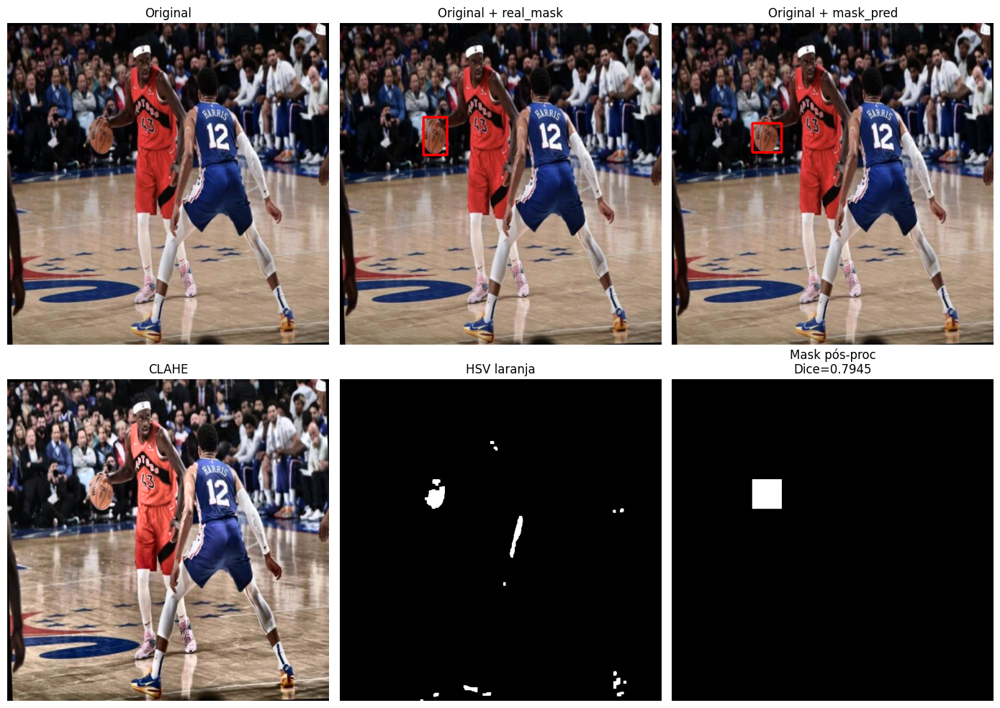

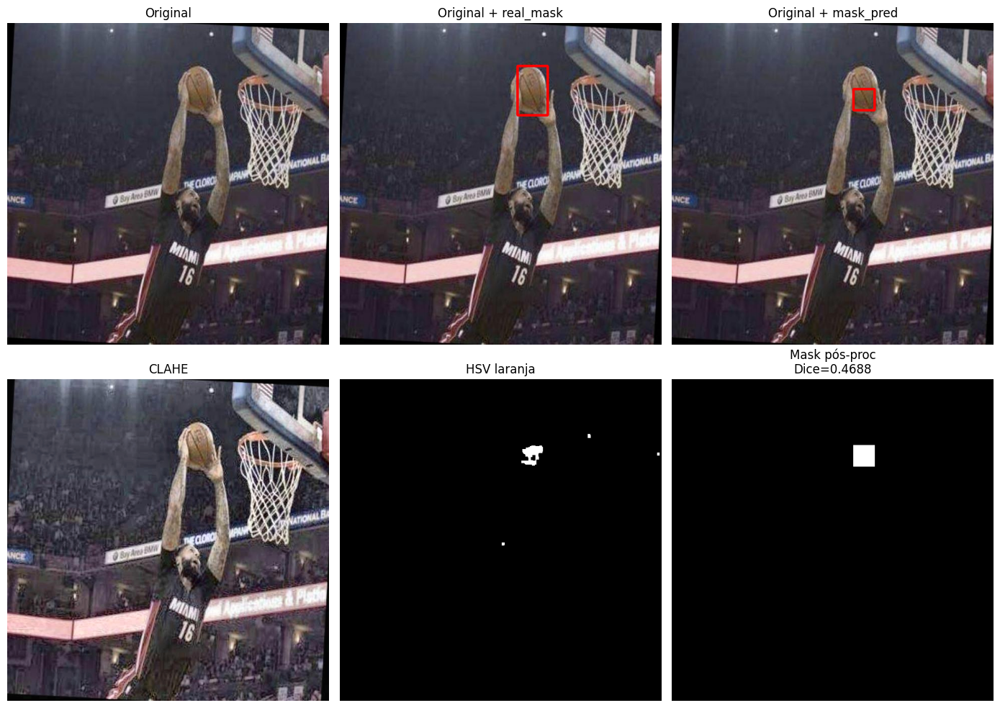

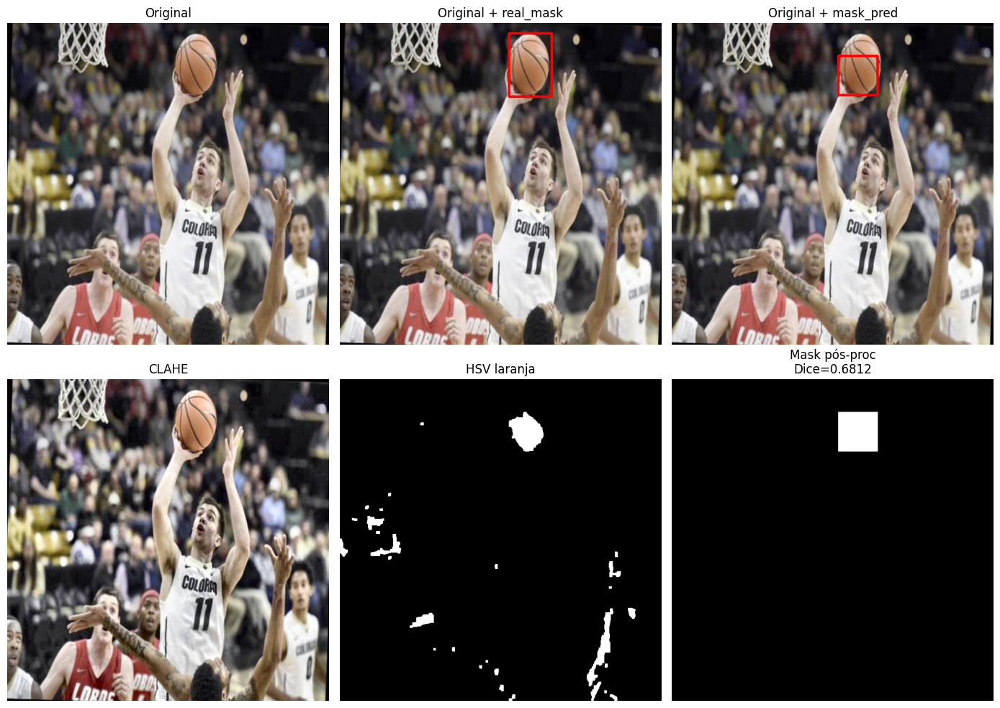

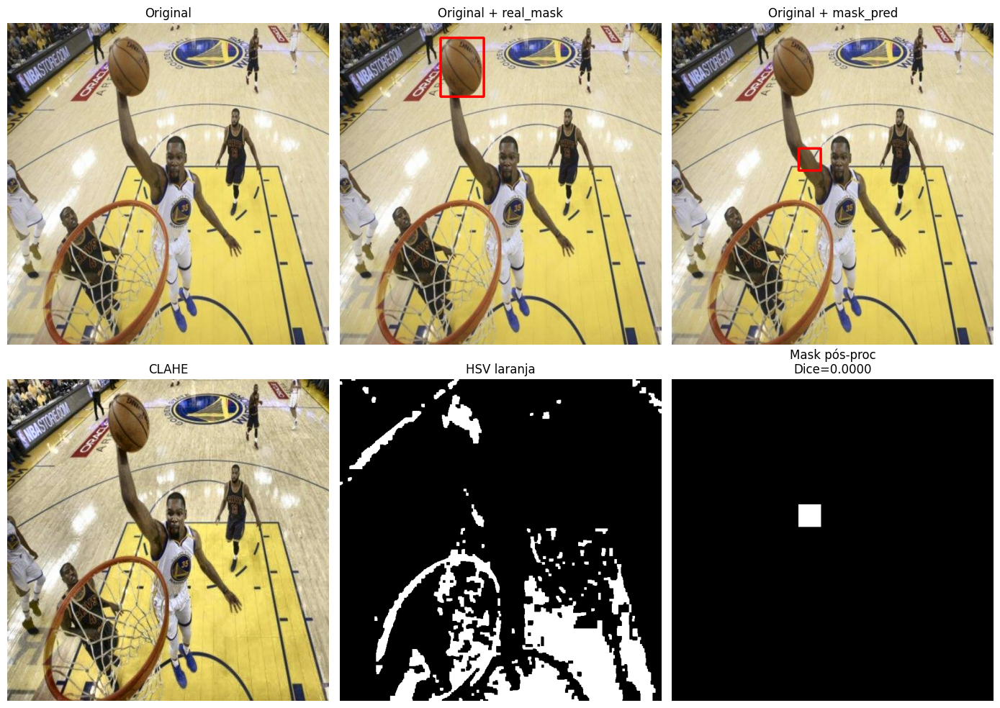

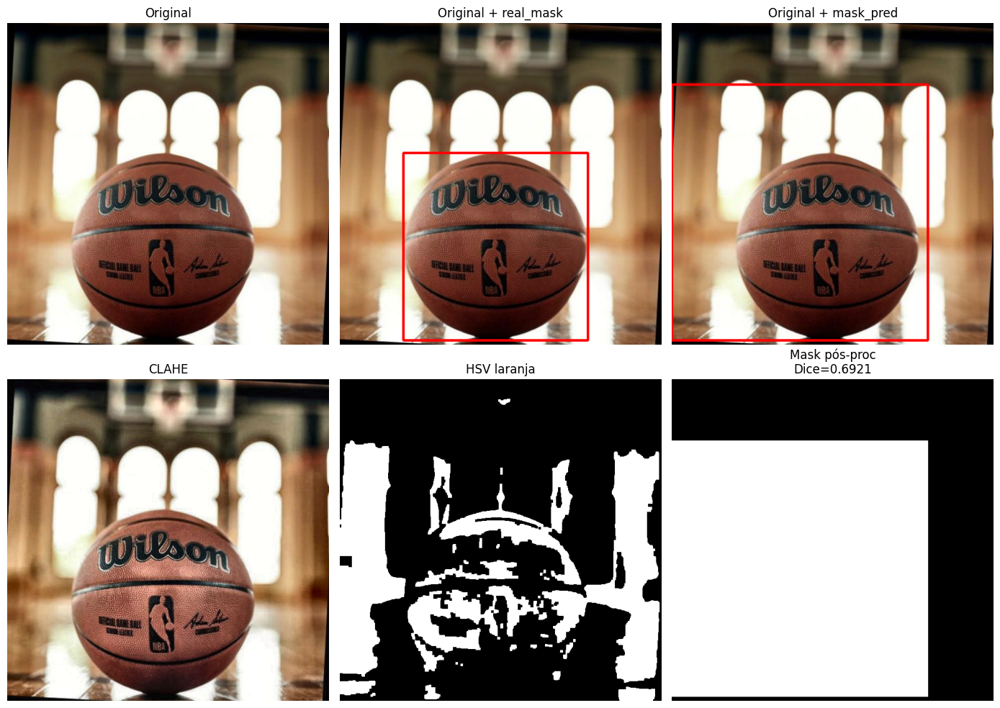

...

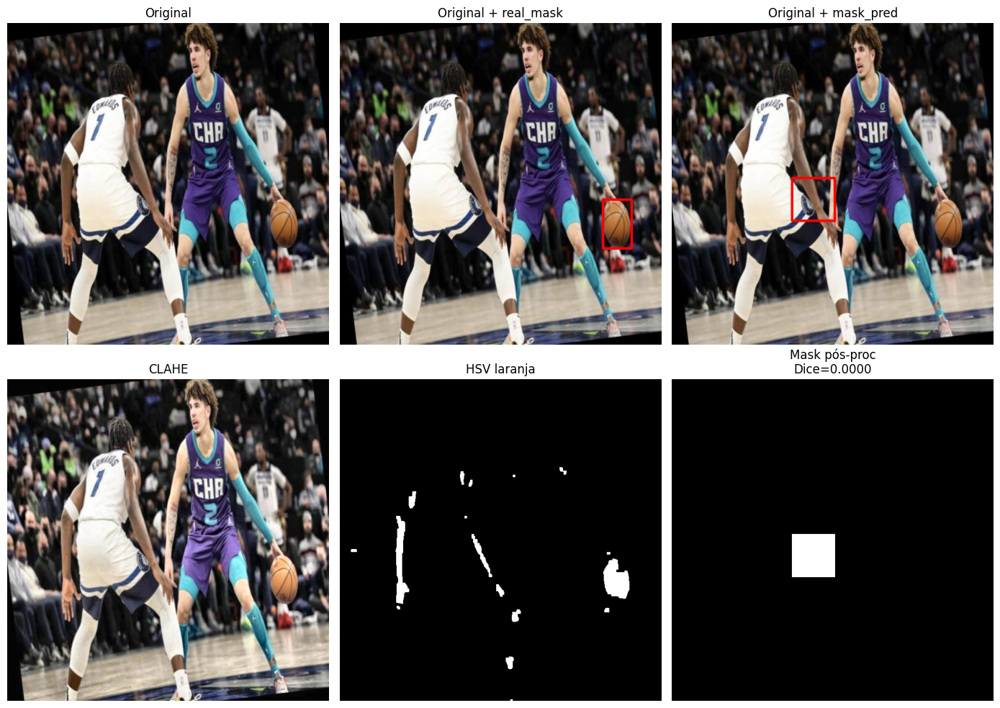

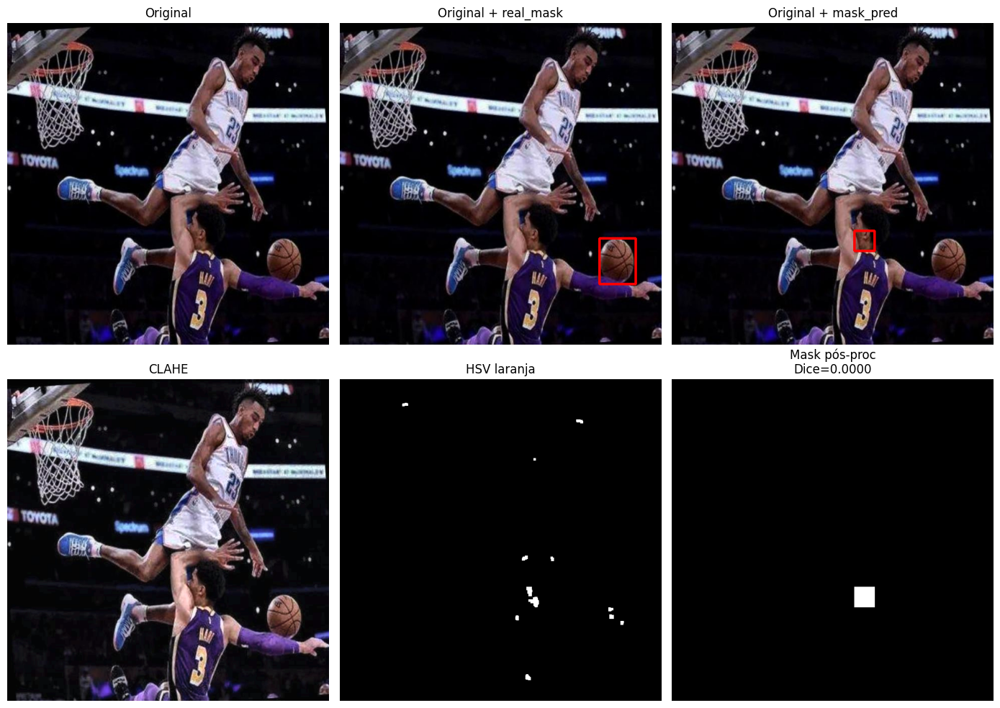

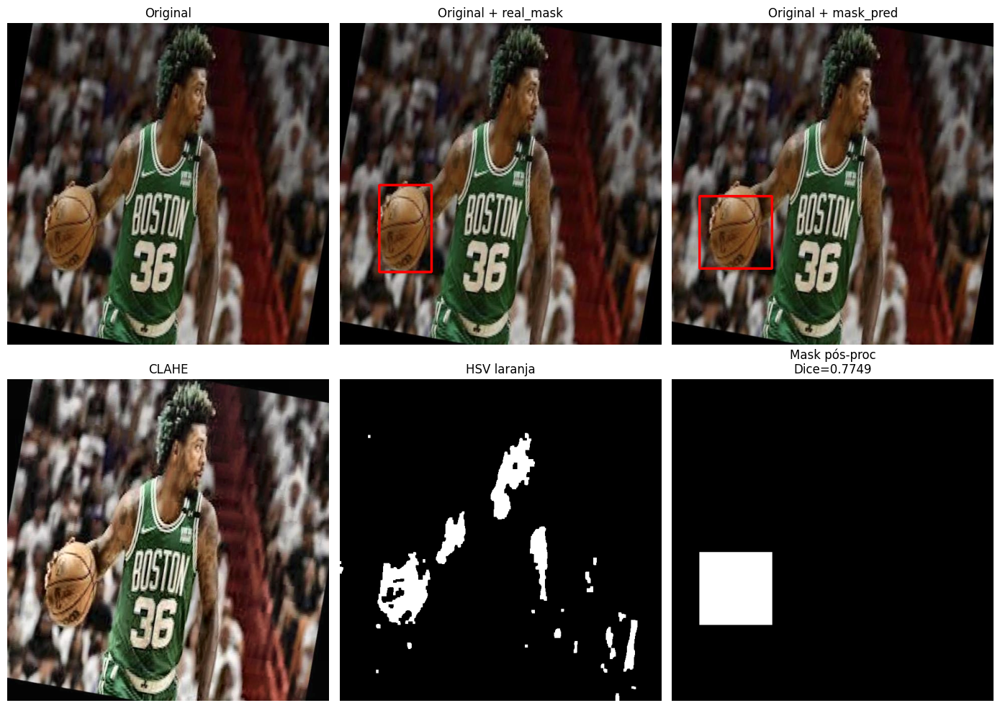

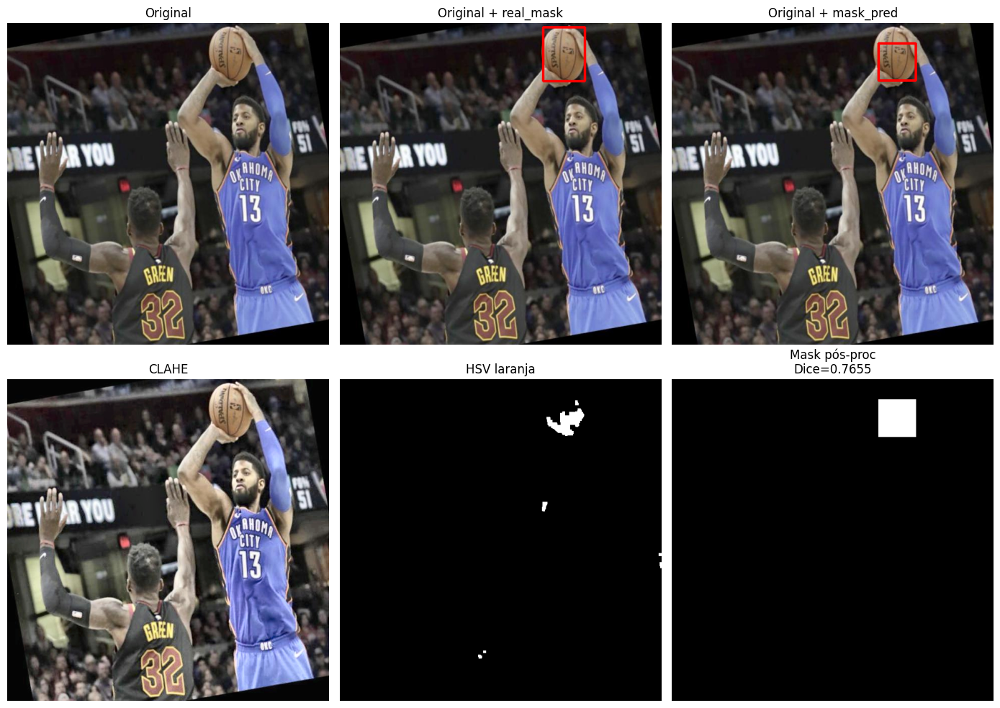

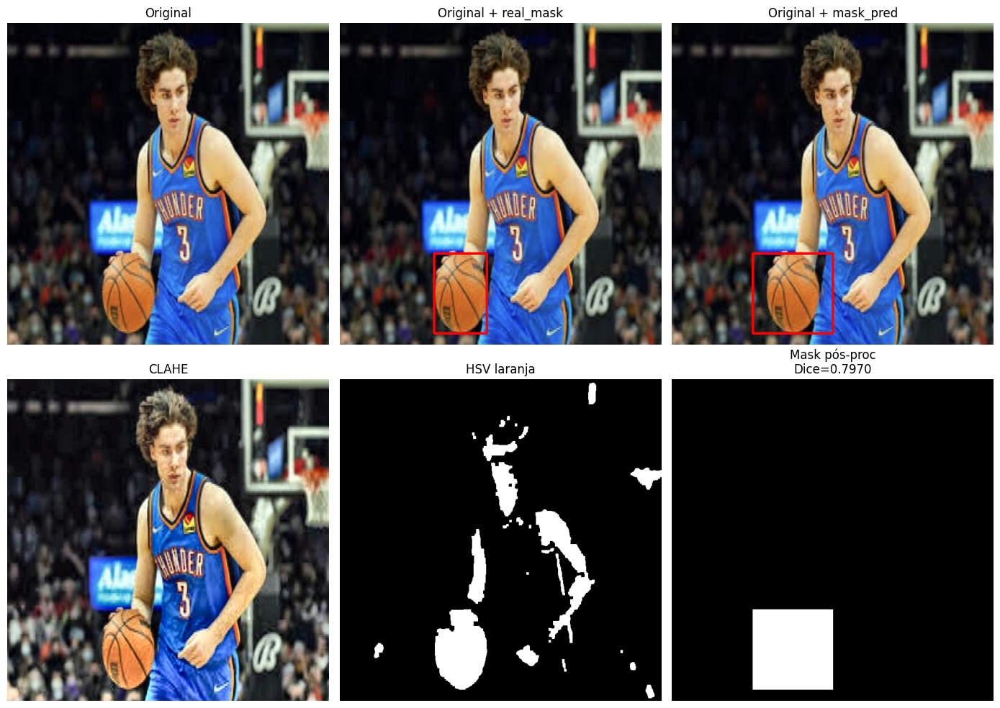

In [39]:
pasta_img = ('/content/drive/MyDrive/ProcessamentoDeImagens/img')
pasta_mask = ('/content/drive/MyDrive/ProcessamentoDeImagens/real_masks')

for nome in os.listdir(pasta_img):
    if not nome.lower().endswith('.jpg'):
        continue

    caminho_img = os.path.join(pasta_img, nome)
    nome_base = os.path.splitext(nome)[0]
    caminho_mask = os.path.join(pasta_mask, f"{nome_base}.png")

    img = cv2.imread(caminho_img)
    mask = cv2.imread(caminho_mask, cv2.IMREAD_GRAYSCALE)

    if img is None or mask is None:
        continue

    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    img_com_real = desenhar_bbox(img_rgb.copy(), mask)

    img_preproc = clahe(img)
    img_preproc_rgb = cv2.cvtColor(img_preproc, cv2.COLOR_BGR2RGB)

    mask_seg = hsv_laranja(img_preproc)

    mask_pred = posproc_mask(mask_seg)

    img_com_pred = desenhar_bbox(img_rgb.copy(), mask_pred)

    dice = dice_coefficient(mask_pred, mask)

    plt.figure(figsize=(14, 10))

    plt.subplot(2, 3, 1)
    plt.title("Original")
    plt.imshow(img_rgb)
    plt.axis("off")

    plt.subplot(2, 3, 2)
    plt.title("Original + real_mask")
    plt.imshow(img_com_real)
    plt.axis("off")

    plt.subplot(2, 3, 3)
    plt.title("Original + mask_pred")
    plt.imshow(img_com_pred)
    plt.axis("off")

    plt.subplot(2, 3, 4)
    plt.title("CLAHE")
    plt.imshow(img_preproc_rgb)
    plt.axis("off")

    plt.subplot(2, 3, 5)
    plt.title("HSV laranja")
    plt.imshow(mask_seg, cmap="gray")
    plt.axis("off")

    plt.subplot(2, 3, 6)
    plt.title(f"Mask pós-proc\nDice={dice:.4f}")
    plt.imshow(mask_pred, cmap="gray")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


### Tiveram 10 casos onde ele não identificou a bola, porém outros métodos conseguiram ou chegaram mais perto. Eles são:

2 - CLAHE e LAB

4 - bilateral e HSV

6 - Original e HSV + Hough

19 - Sharpen e HSV

26 - Sharpen e HSV

32 - Sharpen e Lab

35 - Sharpen e Lab

50 - Sharpen e Lab

70 - Sharpen e HSV

114 - Sharpen e HSV


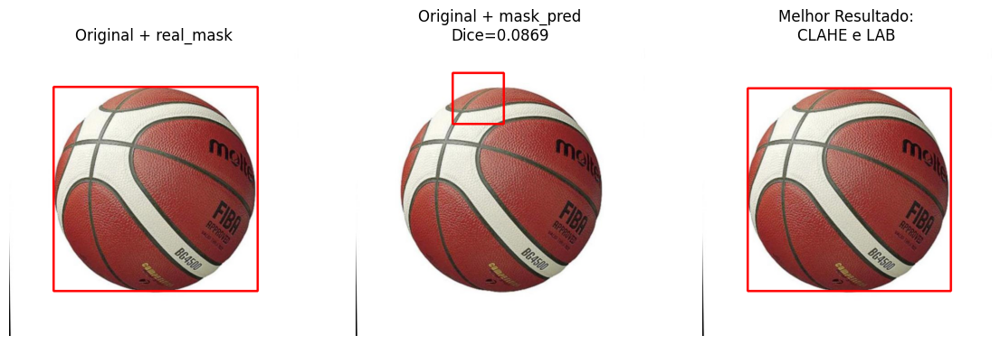

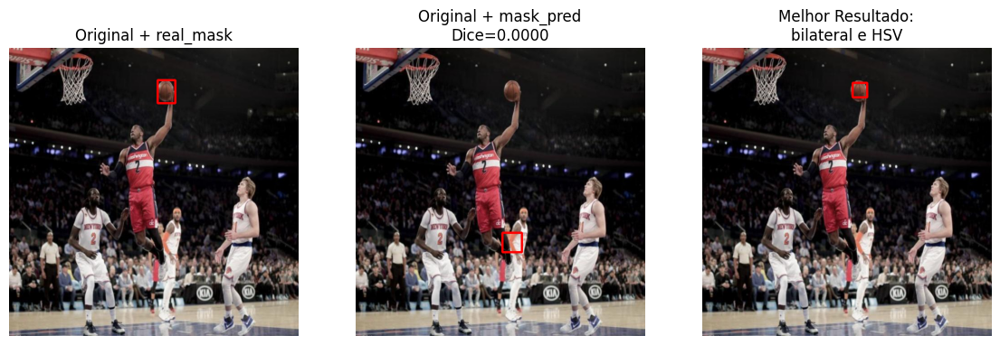

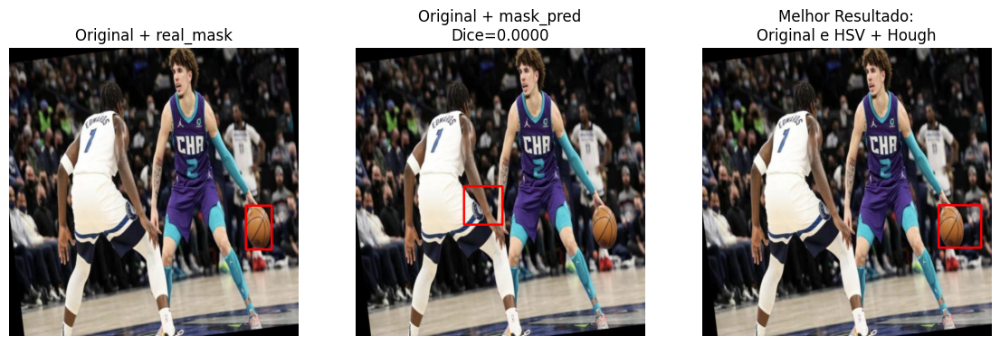

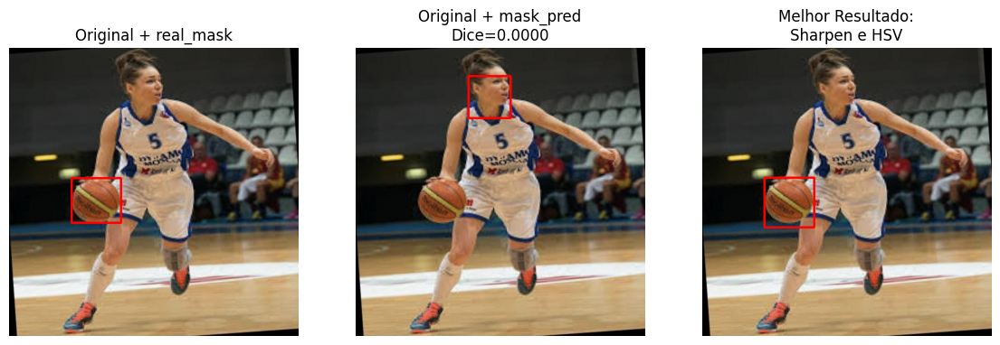

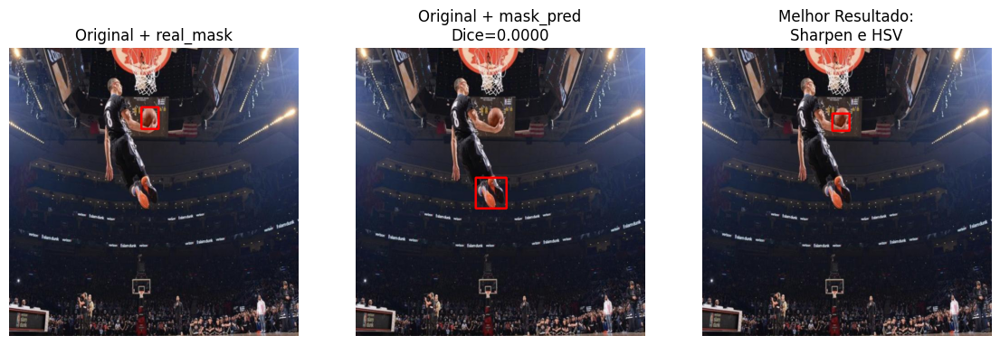

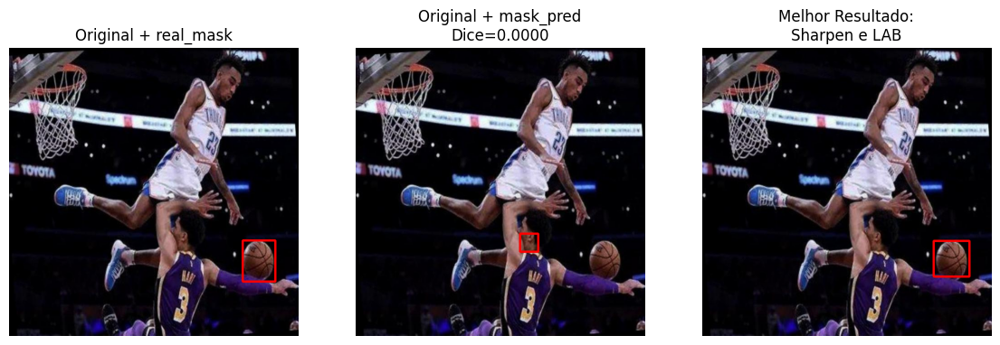

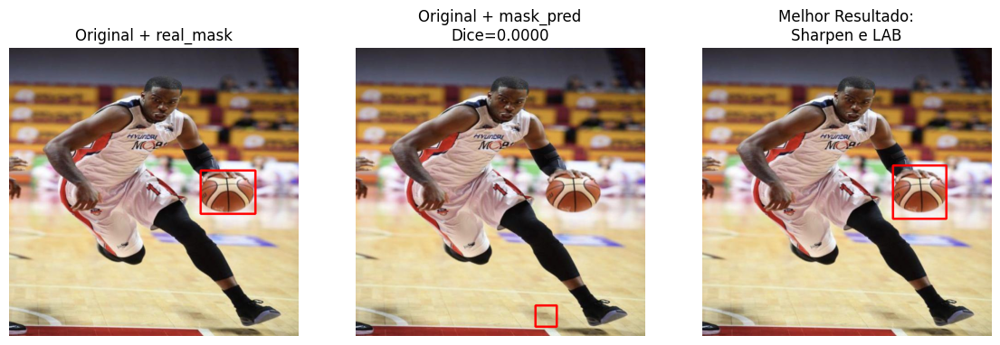

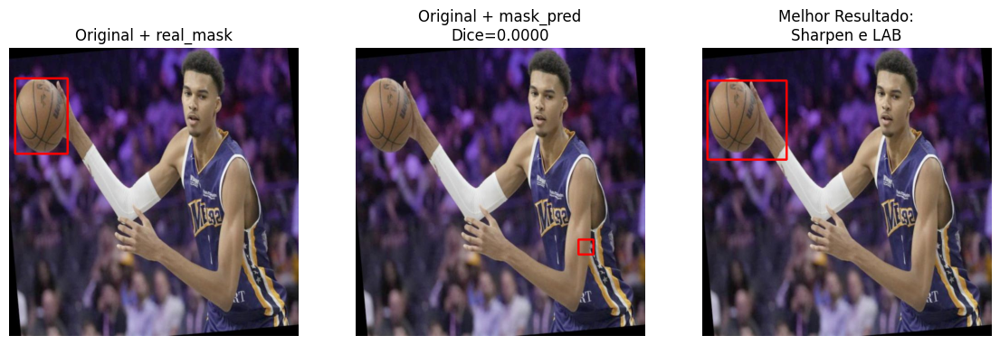

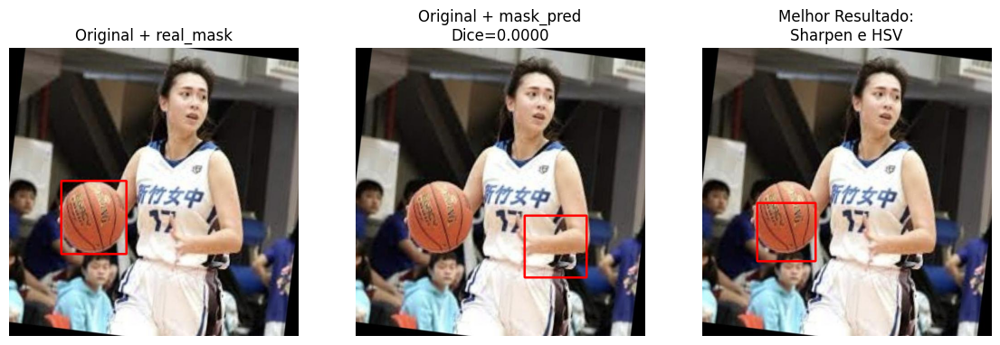

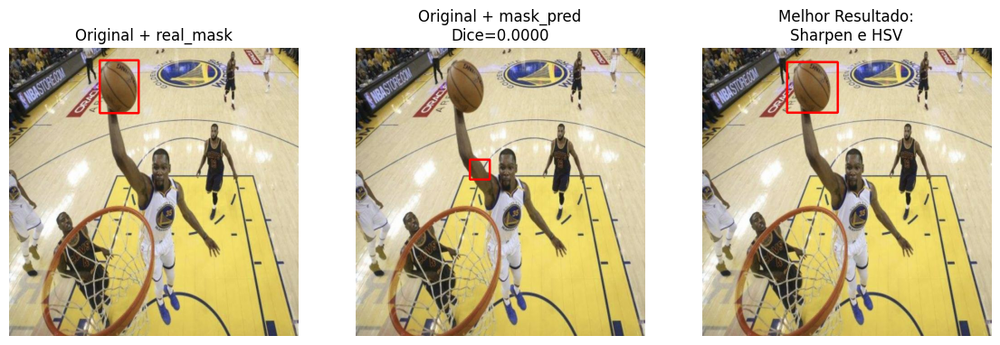

In [42]:
imgs = ['2', '4', '6', '19', '26', '32', '35', '50', '70', '114']

labels = {
    '2': 'CLAHE e LAB',
    '4': 'bilateral e HSV',
    '6': 'Original e HSV + Hough',
    '19': 'Sharpen e HSV',
    '26': 'Sharpen e HSV',
    '32': 'Sharpen e LAB',
    '35': 'Sharpen e LAB',
    '50': 'Sharpen e LAB',
    '70': 'Sharpen e HSV',
    '114': 'Sharpen e HSV'
}

pasta_img = '/content/drive/MyDrive/ProcessamentoDeImagens/img'
pasta_mask = '/content/drive/MyDrive/ProcessamentoDeImagens/real_masks'
pasta_results = '/content/drive/MyDrive/ProcessamentoDeImagens/results'

for img_id in imgs:

    nome_img = f"{img_id}.jpg"
    nome_mask = f"{img_id}.png"

    caminho_img = os.path.join(pasta_img, nome_img)
    caminho_mask = os.path.join(pasta_mask, nome_mask)
    caminho_best = os.path.join(pasta_results, f"bbox_{img_id}.png")

    # Carrega imagens
    img = cv2.imread(caminho_img)
    mask = cv2.imread(caminho_mask, cv2.IMREAD_GRAYSCALE)
    best_img = cv2.imread(caminho_best)

    if img is None or mask is None or best_img is None:
        print(f"Algum arquivo faltando para ID {img_id}")
        continue

    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    img_com_real = desenhar_bbox(img_rgb.copy(), mask)

    img_preproc = clahe(img)
    mask_seg = hsv_laranja(img_preproc)
    mask_pred = posproc_mask(mask_seg)
    img_com_pred = desenhar_bbox(img_rgb.copy(), mask_pred)

    best_img = cv2.cvtColor(best_img, cv2.COLOR_BGR2RGB)
    dice = dice_coefficient(mask_pred, mask)

    plt.figure(figsize=(14, 10))

    plt.subplot(1, 3, 1)
    plt.title("Original + real_mask")
    plt.imshow(img_com_real)
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.title(f"Original + mask_pred\nDice={dice:.4f}")
    plt.imshow(img_com_pred)
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.title(f"Melhor Resultado:\n{labels[img_id]}")
    plt.imshow(best_img)
    plt.axis("off")

    plt.show()
